## Py-imp is the section of the project that is implemented using Python
- This notebook is the data analysis section
- Data was collected at every minute

In [1]:
# Warning options (before all imports)
import warnings
warnings.filterwarnings('ignore')
# warnings.simplefilter(action='ignore', category=UserWarning)
# warnings.simplefilter(action='ignore', category=FutureWarning)
# %xmode Verbose # simplified traceback when an exception occurs
%xmode Plain

Exception reporting mode: Plain


### Install needed packages


In [2]:
# Install a conda package in the current Jupyter kernel
import sys
# !mamba install -c conda-forge --yes --prefix {sys.prefix} <pkg>
# !conda install -c conda-forge --yes --prefix {sys.prefix} <pkg>

# Install a pip package in the current Jupyter kernel
# import sys
# !{sys.executable} - m pip install <pkg>

In [3]:
# 'sklearn for Time series data'
# !mamba install -c conda-forge --yes --prefix {sys.prefix} sktime-all-extras
# 'for Time series data'
# !mamba install -c conda-forge --yes --prefix {sys.prefix} feature_engine
# !mamba install -c conda-forge --yes --prefix {sys.prefix} mlxtend
# !mamba install -c conda-forge --yes --prefix {sys.prefix} statsmodels
# !mamba install -c conda-forge --yes --prefix {sys.prefix} ptitprince
# for tf.keras.utils.plot_model
# !mamba install -c conda-forge --yes --prefix {sys.prefix} graphviz python-graphviz

# # upgrade pip
# !{sys.executable} -m pip install --upgrade pip

# # Debug pip
# # Uninstall SetupTools:
# !{sys.executable} -m pip uninstall pip setuptools
# # Reinstall Setuptools:
# !{sys.executable} -m pip install --upgrade setuptools

# feature engineering Time series data
# !{sys.executable} -m pip install tsfresh
# pretty Matplotlib plots
# !{sys.executable} -m pip install git+https://github.com/iammelvink/LovelyPlots
# better progress bar
# !{sys.executable} -m pip install rich
# better 'describe'
# !{sys.executable} -m pip install skimpy
# For size encoded heatmaps
# !{sys.executable} -m pip install heatmapz
# XGBoost
# !{sys.executable} -m pip install xgboost
# !{sys.executable} -m pip install lightgbm
# !{sys.executable} -m pip install catboost
# !{sys.executable} -m pip install fastprogress
# !{sys.executable} -m pip install matplotx[all]
# !{sys.executable} -m pip install matplotx
# !{sys.executable} -m pip install lux
# !jupyter nbextension install --py luxwidget
# !jupyter nbextension enable --py luxwidget

# !{sys.executable} -m pip install sweetviz
# !{sys.executable} -m pip install yellowbrick
# !{sys.executable} -m pip install autoviz
# !{sys.executable} -m pip install pandas-profiling
# !{sys.executable} -m pip install dtale
# !{sys.executable} -m pip install sketch
# !{sys.executable} -m pip install watermark
# !{sys.executable} -m pip install snoop
# for tf.keras.utils.plot_model
# !{sys.executable} -m pip install pydot
# !{sys.executable} -m pip install waterfallcharts

# !{sys.executable} -m pip install matplotlib pandas==1.5.3 --force-reinstall

In [4]:
# %pip install <pkg> --user

### Importing libraries


In [5]:
import snoop

snoop.install()
%load_ext snoop
# eg. put this before debug code %%snoop

from skimpy import skim  # better describe
from rich.progress import track
import os, random
import timeit

import math
from scipy.stats import chi2_contingency

# Dataset reducer
# Source: https://www.kaggle.com/code/joseguzman/reducing/notebook
from reducing import PandaReducer

# Local ChatGPT-ish
import sketch
os.environ["SKETCH_MAX_COLUMNS"] = "300"
os.environ["SKETCH_ROW_OVERRIDE_LIMIT"] = "5"

# Run locally
# os.environ["LAMBDAPROMPT_BACKEND"] = "StarCoder"
# os.environ["SKETCH_USE_REMOTE_LAMBDAPROMPT"] = "False"
# os.environ["HF_ACCESS_TOKEN"] = "your_hugging_face_token"

# EDA
import numpy as np
import pandas as pd
import sweetviz as sv
# from autoviz import FixDQ # auto clean dataset
from autoviz.AutoViz_Class import AutoViz_Class
from pandas_profiling import ProfileReport
import dtale
# import lux
# lux.config.default_display = "lux" # to display LUX by default
# lux.config.sampling = False # to turn off sampling
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from matplotlib import cycler
from matplotlib import rcParams
# matplotlib extensions
import matplotx
# For better distribution plots
# import ptitprince as pt
# For size encoded heatmaps
from heatmap import *
# import waterfall_chart as wfc

# Pre-processing
from sklearn.preprocessing import *
from feature_engine.creation import CyclicalFeatures
from feature_engine.datetime import DatetimeFeatures
from feature_engine.imputation import DropMissingData
from feature_engine.selection import DropFeatures
from feature_engine.timeseries.forecasting import *
from mlxtend.evaluate.time_series import *
import datetime
from datetime import datetime as dt
from dateutil.relativedelta import *
from sklearn.compose import *
from sklearn.preprocessing import *
from sklearn.impute import *
from sklearn.pipeline import *

# Modeling
import tensorflow as tf
from tensorflow import keras
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.model_selection import *
from sklearn.model_selection import *
from sktime.utils.plotting import plot_series
from sklearn.utils import *
from sklearn.ensemble import *
from sklearn.naive_bayes import *
from sklearn.metrics import *
from sklearn import metrics
from sklearn.linear_model import *
from sklearn.neighbors import *
from sklearn.tree import *
from sklearn.svm import *
from xgboost import *
from lightgbm import *
from catboost import *
from sklearn.utils.class_weight import *
from sklearn.exceptions import NotFittedError
import pickle

np.set_printoptions(linewidth=140)

# Pandas options
# pd.options.display.precision = 3
pd.options.display.max_rows = 250
pd.options.display.max_columns = 100
pd.options.mode.chained_assignment=None

pd.set_option('display.width', 140)

# Display Pipelines and models
from sklearn import set_config
set_config(display='diagram')

plt.style.reload_library()
# plt.style.use(matplotx.styles.dufte)
# plt.style.use('ipynb') # prettier plots
plt.style.use(['ipynb', 'colors10-markers'])
# Always put after custom styles
rcParams['axes.spines.top'] = False # remove top border of plot
rcParams['axes.spines.bottom'] = True # keep top border of plot
rcParams['axes.spines.left'] = True # keep top border of plot
rcParams['axes.spines.right'] = True # keep top border of plot
# rcParams['axes.grid' ] = True
rcParams["figure.figsize"] = plt.rcParamsDefault["figure.figsize"] # reset figsize

# To display charts in Jupyter
%matplotlib inline

# Matplotlib options
rcParams['figure.dpi'] = 600
# rcParams['figure.figsize'] = 8, 6
rcParams['legend.fontsize'] = "large"
rcParams['xtick.major.size'] = 4
rcParams['xtick.minor.size'] = 1
rcParams["figure.autolayout"] = True

# For reproducibility
# rng = np.random.RandomState(0)
rng = 777
os.environ['PYTHONHASHSEED'] = str(rng)
random.seed(rng)
np.random.seed(rng)
tf.random.set_seed(rng)

# Set the seed using keras.utils.set_random_seed. This will set:
# 1) `numpy` seed
# 2) `tensorflow` random seed
# 3) `python` random seed
tf.keras.utils.set_random_seed(rng)

# This will make TensorFlow ops as deterministic as possible, but it will
# affect the overall performance, so it's not enabled by default.
# `enable_op_determinism()` is introduced in TensorFlow 2.9.
# tf.config.experimental.enable_op_determinism()
os.environ["TF_DETERMINISTIC_OPS"] = "True"
os.environ["TF_DISABLE_SEGMENT_REDUCTION_OP_DETERMINISM_EXCEPTIONS"] = "True"

Imported AutoViz_Class version: 0.1.24. Call using:
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Note: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.


In [6]:
%load_ext watermark
# %watermark
%watermark --iversions

sweetviz  : 2.2.1
xgboost   : 2.0.0
sklearn   : 1.3.1
matplotx  : 0.3.10
matplotlib: 3.7.1
dtale     : 3.5.0
scipy     : 1.10.1
sys       : 3.8.17 | packaged by conda-forge | (default, Jun 16 2023, 07:01:59) [MSC v.1929 64 bit (AMD64)]
seaborn   : 0.11.0
tensorflow: 2.10.1
sketch    : 0.4.2
keras     : 2.10.0
numpy     : 1.23.5
pandas    : 1.5.3



In [7]:
# Helper function for autoviz
def autoviz_custom(dfte, save_plot_dir):
    # EDA using Autoviz
    autoviz = AutoViz_Class().AutoViz(
        # filename= f"{data_path}/PdM_water_pump.csv")",
        filename="",
        sep=",",
        depVar="",
        # dfte=None,
        dfte=dfte,
        header=0,  # 0 = first row is header & None = no header
        # verbose=0,
        verbose=2,
        lowess=False,
        chart_format="png",
        # chart_format="svg",
        # chart_format="bokeh",
        # chart_format="html",
        max_rows_analyzed=5000000,
        # max_rows_analyzed=15,
        max_cols_analyzed=50000,
        # save_plot_dir=here('./Assets/EDA')
        save_plot_dir=save_plot_dir
    )
    return autoviz

In [8]:
# Helper functions to export lux plots to matplotlib code
def export_vis(df):  # define a function that takes a dataframe as an argument
    vis_list = df.exported  # get the list of Vis objects
    for vis in vis_list:  # loop over the list
        plt_code = vis.to_matplotlib()  # translate to Matplotlib code
        print(plt_code)  # print the Matplotlib code
        # save the plot as an image file with a unique name
        # plt_code.savefig(f"vis{i}.png")

In [9]:
# Helper functions for getting descriptive statistics
def plot_boxh_groupby(dataset, feature_name, by):
    """
    Box plot with groupby
    
    df: DataFrame
    feature_name: Name of the feature to be plotted
    by: Name of the feature based on which groups are created
    """
    dataset.boxplot(column=feature_name, by=by, vert=False,
                    figsize=(10, 6))

    # disable offset, scientific notation looking
    # plt.ticklabel_format(useOffset=False, style='plain')
    plt.title(f'Distribution of {feature_name} by {by}')
    plt.show()


def plot_hist(dataset, feature_name, kind='hist', bins=100, log=True):
    """
    Plot histogram.
    
    df: DataFrame
    feature_name: Name of the feature to be plotted.
    """
    if log:
        dataset[feature_name].apply(np.log1p).plot(kind='hist',
                                                   bins=bins,
                                                   figsize=(15, 5),
                                                   title=f'Distribution of log1p[{feature_name}]')
    else:
        dataset[feature_name].plot(kind='hist',
                                   bins=bins,
                                   figsize=(15, 5),
                                title=f'Distribution of {feature_name}')
    plt.show()


def plot_ts(series, figsize=(20, 6), title=None, xlabel="", ylabel=""):
    """
    Plot Time Series data. The series object should have date or time as index.
    
    series: Series object to be plotted.
    """
    series.plot(figsize=figsize, title=title)

    # make x-axis ticks legible
    fig = plt.gcf()
    fig.autofmt_xdate()  # auto format data
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()


def plot_barh(dataset, feature_name, normalize=True,
              kind='barh', figsize=(15, 5), sort_index=False, title=None):
    """
    Plot barh for a particular feature
    
    kind : Type of the plot
    
    """
    if sort_index == True:
        dataset[feature_name].value_counts(
            normalize=normalize, dropna=False).sort_index().plot(
            kind=kind, figsize=figsize, grid=True,
            title=title)
    else:
        dataset[feature_name].value_counts(
            normalize=normalize, dropna=False).sort_values().plot(
            kind=kind, figsize=figsize, grid=True,
            title=title)
    plt.legend()
    plt.show()


def plot_boxh(dataset, feature_name, kind='box', log=True):
    """
    Box plot
    """
    if log:
        dataset[feature_name].apply(np.log1p).plot(kind='box', vert=False,
                                                   figsize=(10, 6),
                                                   title=f'Distribution of log1p[{feature_name}]')
    else:
        dataset[feature_name].plot(kind='box', vert=False,
                                   figsize=(10, 6),
                                   title=f'Distribution of {feature_name}')
    plt.show()


def plot_scatter(dataset, feature_x, feature_y, figsize=(10, 10),
                 title=None, xlabel=None, ylabel=None):
    """
    Plot satter     
    """
    dataset.plot.scatter(feature_x, feature_y,
                         figsize=(8, 6), title=title,
                         legend=None)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()


def lower_col_name(dataset):
    lower_cols = [col.lower() for col in dataset.columns]
    dataset.columns = lower_cols
    return dataset.head(3)

In [10]:
# Helper functions for categorical type casting
def summarize_categoricals(df, show_levels=False):
    """
    Display uniqueness in each column and percentage of missing values
    """
    data = [[df[c].unique(), len(df[c].unique()), df[c].isnull().sum(), 
             df[c].isnull().mean() * 100]  # Calculate percentage of missing values
            for c in df.columns]
    df_temp = pd.DataFrame(data, index=df.columns,
                           columns=['Levels', 'No. of Levels',
                                    'No. of Missing Values', 'Percentage of Missing Values'])
    
    return df_temp.iloc[:, 0 if show_levels else 1:]


def return_categoricals(df, threshold=5):
    """
        Returns a list of columns that have less than or equal to
        `threshold` number of unique categorical levels
    """
    return list(filter(lambda c: c if len(df[c].unique()) <= threshold else None,
                       df.columns))


def to_categorical(columns, df):
    """
        Converts the columns passed in `columns` to categorical datatype
    """
    for col in columns:
        df[col] = df[col].astype('category')
    return df

In [11]:
# allow memory growth of GPU
physical_devices = tf.config.experimental.list_physical_devices('GPU')
for device in physical_devices:
    tf.config.experimental.set_memory_growth(device, True)

<a id="import-and-clean-data"></a>
## 1.   Import and Clean Data

In [12]:
data_path = "../../data/d_pump/"

water_pump = pd.read_csv(f"{data_path}/sensor.csv", parse_dates=["timestamp"])

# Rename timestamp column to datetime
water_pump.rename(columns={'timestamp': 'datetime'}, inplace=True)

# Rename machine_status column to pump_status
water_pump.rename(columns={'machine_status': 'pump_status'}, inplace=True)

# Convert pump_status to lowercase
water_pump.loc[:,'pump_status'] = water_pump.loc[:,'pump_status'].str.lower()

# Changing format's of date-time columns. Sort based on date for better readability
tables = [water_pump]
for dataset in tables:
    dataset.sort_values(["datetime"],
    inplace=True, ignore_index=True)

<a id="missing-values"></a>
### 1.1.   Missing values and type casting to categoricals/numeric

In [13]:
# Create a dictionary to store the datasets and their names
datasets = {
    'Water pump': water_pump,
}

# Iterate through the datasets and print the count and percentage of missing values
for name, df in datasets.items():
    print(f"Missing values in {name} dataset:")
    missing_count = df.isnull().sum()
    total_entries = len(df)
    missing_percentage = (missing_count / total_entries) * 100
    missing_info = pd.DataFrame({
        'Missing Count': missing_count,
        'Missing Percentage': missing_percentage
    })
    print(missing_info)
    print("=" * 50)  # Separator between datasets

Missing values in Water pump dataset:
             Missing Count  Missing Percentage
Unnamed: 0               0            0.000000
datetime                 0            0.000000
sensor_00            10208            4.633261
sensor_01              369            0.167484
sensor_02               19            0.008624
sensor_03               19            0.008624
sensor_04               19            0.008624
sensor_05               19            0.008624
sensor_06             4798            2.177741
sensor_07             5451            2.474129
sensor_08             5107            2.317992
sensor_09             4595            2.085603
sensor_10               19            0.008624
sensor_11               19            0.008624
sensor_12               19            0.008624
sensor_13               19            0.008624
sensor_14               21            0.009532
sensor_15           220320          100.000000
sensor_16               31            0.014070
sensor_17             

In [14]:
print(f"Summary for DataFrame: Water pump")
summarize_categoricals(water_pump, show_levels=True)

Summary for DataFrame: Water pump


,Levels,No. of Levels,No. of Missing Values,Percentage of Missing Values
Unnamed: 0,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",220320,0,0.000000
datetime,"[2018-04-01T00:00:00.000000000, 2018-04-01T00:...",220320,0,0.000000
sensor_00,"[2.465394, 2.444734, 2.460474, 2.445718, 2.453...",1254,10208,4.633261
sensor_01,"[47.09201, 47.35243, 47.13541, 47.04861, 47.17...",832,369,0.167484
sensor_02,"[53.2118, 53.1684, 53.168399810790994, 53.125,...",832,19,0.008624
sensor_03,"[46.31076, 46.39757, 46.3975677490234, 46.3107...",589,19,0.008624
sensor_04,"[634.375, 638.8889, 628.125, 636.4583, 637.615...",7845,19,0.008624
sensor_05,"[76.45975, 73.54598, 76.98898, 76.588969999999...",190752,19,0.008624
sensor_06,"[13.41146, 13.32465, 13.317420000000002, 13.35...",813,4798,2.177741
sensor_07,"[16.13136, 16.037329999999997, 16.24711, 16.21...",532,5451,2.474129


In [15]:
to_cast = return_categoricals(water_pump, threshold=5)
water_pump = to_categorical(to_cast, water_pump)
water_pump.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220320 entries, 0 to 220319
Data columns (total 55 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   Unnamed: 0   220320 non-null  int64         
 1   datetime     220320 non-null  datetime64[ns]
 2   sensor_00    210112 non-null  float64       
 3   sensor_01    219951 non-null  float64       
 4   sensor_02    220301 non-null  float64       
 5   sensor_03    220301 non-null  float64       
 6   sensor_04    220301 non-null  float64       
 7   sensor_05    220301 non-null  float64       
 8   sensor_06    215522 non-null  float64       
 9   sensor_07    214869 non-null  float64       
 10  sensor_08    215213 non-null  float64       
 11  sensor_09    215725 non-null  float64       
 12  sensor_10    220301 non-null  float64       
 13  sensor_11    220301 non-null  float64       
 14  sensor_12    220301 non-null  float64       
 15  sensor_13    220301 non-null  floa

- sensor_15 is observed to be faulty due to it having 100% missing values. So, we will drop it.
- sensor_50 is also observed to be faulty due to it having over 34% missing values, which indicates about third of the values are missing. So, we will drop it.
- Also drop the 'Unamed 0' column because it is just an index column which is not useful for the analysis.

In [16]:
# Also drop the 'Unamed 0' column because it is just an index column which is not useful for the analysis.
water_pump.drop(water_pump.columns[0], axis=1, inplace=True)

# sensor_15 is observed to be faulty due to it having 100% missing values. So, we will drop it.
# sensor_50 is also observed to be faulty due to it having over 34% missing values, which indicates about third of the values are missing. So, we can will it.
water_pump.drop(['sensor_15', 'sensor_50'], axis=1, inplace=True)

water_pump = PandaReducer().reduce(water_pump)

Dataset reduced 0.00% : 85.94 to 85.94 MB in 3.20 seconds


In [17]:
# Get the average of the original dataset
df_mean = water_pump.mean()

In [18]:
# Get the max of the original dataset
df_max_compare = water_pump.max(numeric_only=True)

In [19]:
# Get the min of the original dataset
df_min_compare = water_pump.min(numeric_only=True)

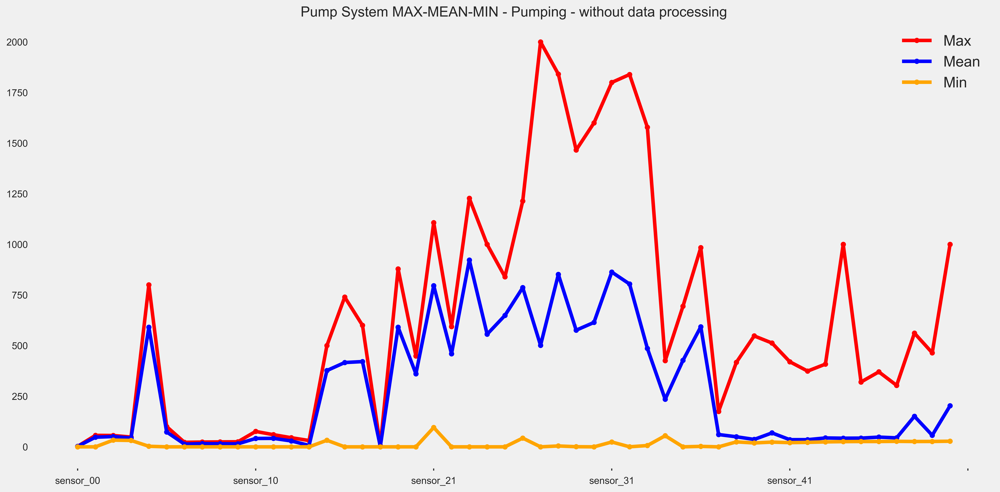

In [20]:
# Pump System MAX-MEAN-MIN - Pumping - without data processing
# Get the coordinates of the max and min values
# max_x = df_max_compare.idxmax()
# max_y = df_max_compare.max()
# min_x = df_min_compare.idxmin()
# min_y = df_min_compare.min()

# # Annotate the max and min values with text and arrows
# plt.annotate(f'Max = {max_y:.2f}', xy=(max_x, max_y), xytext=(max_x + 1, max_y + 0.5), arrowprops=dict(arrowstyle='->', color='red')) 
# plt.annotate(f'Min = {min_y:.2f}', xy=(min_x, min_y), xytext=(min_x - 1, min_y - 0.5), arrowprops=dict(arrowstyle='->', color='orange'))

# Get the coordinates of the max and min values
# max_x = pd.to_datetime(df_max_compare.idxmax())
# max_y = df_max_compare.max()
# min_x = pd.to_datetime(df_min_compare.idxmin())
# min_y = df_min_compare.min()

# # Annotate the max and min values with text and arrows
# plt.annotate(f'Max = {max_y:.2f}', xy=(max_x, max_y), xytext=(max_x + pd.Timedelta(days=1), max_y + 0.5), arrowprops=dict(arrowstyle='->', color='red'))
# plt.annotate(f'Min = {min_y:.2f}', xy=(min_x, min_y), xytext=(min_x - pd.Timedelta(days=1), min_y - 0.5), arrowprops=dict(arrowstyle='->', color='orange'))

df_max_compare.plot.line(figsize=(16,8), marker='o', color='red', label='Max').set_title('Pump System MAX-MEAN-MIN - Pumping - without data processing', fontsize=16)
df_mean.plot.line(marker='o', color='blue', label='Mean')
df_min_compare.plot.line(marker='o', color='orange', label='Min')

plt.legend();

Descriptive statistics for Water pump data

In [21]:
print("Total number of water_pump records: %d" % len(water_pump.index))
print(water_pump.head(3))
# skim(water_pump)
# water_pump.describe().T.style.background_gradient(axis=0, cmap='YlOrRd')
water_pump.describe().T.style.highlight_min(axis=0, color='lightgrey').highlight_max(axis=0, color='lightblue')

Total number of water_pump records: 220320
             datetime  sensor_00  sensor_01  sensor_02  sensor_03  sensor_04  sensor_05  sensor_06  sensor_07  sensor_08  sensor_09  \
0 2018-04-01 00:00:00   2.465394   47.09201    53.2118   46.31076   634.3750   76.45975   13.41146   16.13136   15.56713   15.05353   
1 2018-04-01 00:01:00   2.465394   47.09201    53.2118   46.31076   634.3750   76.45975   13.41146   16.13136   15.56713   15.05353   
2 2018-04-01 00:02:00   2.444734   47.35243    53.2118   46.39757   638.8889   73.54598   13.32465   16.03733   15.61777   15.01013   

   sensor_10  sensor_11  sensor_12  sensor_13  sensor_14  sensor_16  sensor_17  sensor_18  sensor_19  sensor_20  sensor_21  sensor_22  \
0   37.22740   47.52422   31.11716   1.681353   419.5747   461.8781   466.3284   2.565284   665.3993   398.9862   880.0001   498.8926   
1   37.22740   47.52422   31.11716   1.681353   419.5747   461.8781   466.3284   2.565284   665.3993   398.9862   880.0001   498.8926   
2   3

,count,mean,std,min,25%,50%,75%,max
sensor_00,210112.000000,2.372221,0.412227,0.000000,2.438831,2.456539,2.499826,2.549016
sensor_01,219951.000000,47.591611,3.296666,0.000000,46.310760,48.133678,49.479160,56.727430
sensor_02,220301.000000,50.867392,3.666820,33.159720,50.390620,51.649300,52.777770,56.032990
sensor_03,220301.000000,43.752481,2.418887,31.640620,42.838539,44.227428,45.312500,48.220490
sensor_04,220301.000000,590.673936,144.023912,2.798032,626.620400,632.638916,637.615723,800.000000
sensor_05,220301.000000,73.396414,17.298247,0.000000,69.976260,75.576790,80.912150,99.999880
sensor_06,215522.000000,13.501537,2.163736,0.014468,13.346350,13.642940,14.539930,22.251160
sensor_07,214869.000000,15.843152,2.201155,0.000000,15.907120,16.167530,16.427950,23.596640
sensor_08,215213.000000,15.200721,2.037390,0.028935,15.183740,15.494790,15.697340,24.348960
sensor_09,215725.000000,14.799210,2.091963,0.000000,15.053530,15.082470,15.118630,25.000000


- The maximum speed of the water pump is observed to be 2000

Temp resample the data from minute rate to hourly rate to generate plots faster

In [22]:
# Set the datetime column as the index
temp_water_pump = water_pump.set_index('datetime')

In [23]:
# Temp resample the data from minute rate to hourly rate to generate plots faster
temp_water_pump = temp_water_pump.resample("H").mean()

In [24]:
# Drop datetime column
temp_water_pump.reset_index(inplace=True)
temp_water_pump = temp_water_pump.drop("datetime", axis=1)

Duration of the water_pump data

In [25]:
# Duration of the water_pump data
print("Duration of the water_pump data:")
water_pump.datetime.min(), water_pump.datetime.max()

Duration of the water_pump data:


(Timestamp('2018-04-01 00:00:00'), Timestamp('2018-08-31 23:59:00'))

<a id="data-visualization"></a>
## 3.   Data Visualization

#### EDA on Water pump

In [26]:
plt.figure(figsize=(15, 10))
ax = water_pump['pump_status'].value_counts().plot(kind='bar')
plt.ylabel('Count')
plt.xlabel('Pump status')
plt.title('Count and percentage of each Pump status')
total = water_pump['pump_status'].count()
for p in ax.patches:
    count = p.get_height()
    percent = '{:.3f}%'.format(100 * count / total)
    ax.annotate(str(count) + '\n' + percent + '\n', (p.get_x() + p.get_width() / 2., p.get_height()),
                va='center', ha='center', fontweight='bold', 
                color='#000', xytext=(0, 10), textcoords='offset points')
plt.show();

- A major class imbalance is observed in machine status
- To preserve the data as much as possible, this research uses cost-sensitive ML to account for the class imbalance

In [27]:
temp_water_pump.plot(subplots = True, sharex = True, figsize = (20,50));

- Cavitation may have occured which may explain the peaks obsevered (Cavitation - when bubbles form in a liquid)

In [ ]:
water_pump_dtale = dtale.show(water_pump)
dtale.show(water_pump)
dtale.show(water_pump).open_browser()

In [28]:
# Analyzing the water_pump dataset
water_pump_df_report = sv.analyze(water_pump)

                                             |          | [  0%]   00:00 -> (? left)

Report ./Assets/EDA/sweetviz/water_pump_df_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



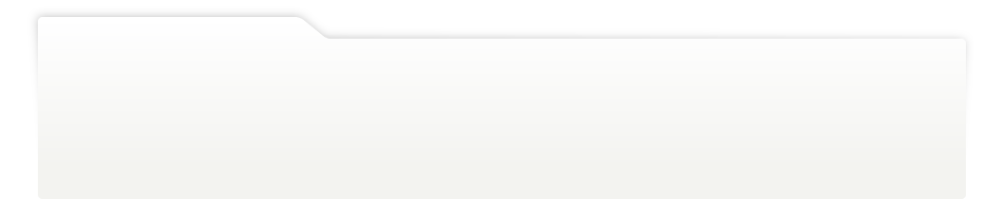
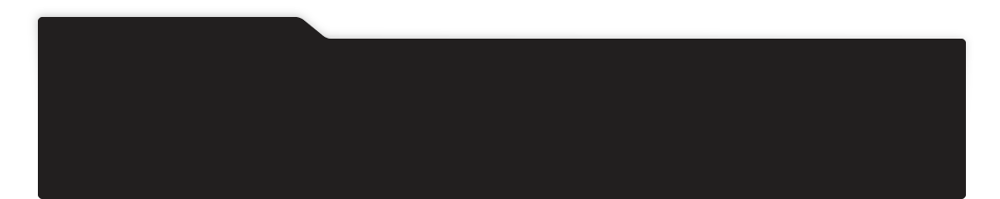
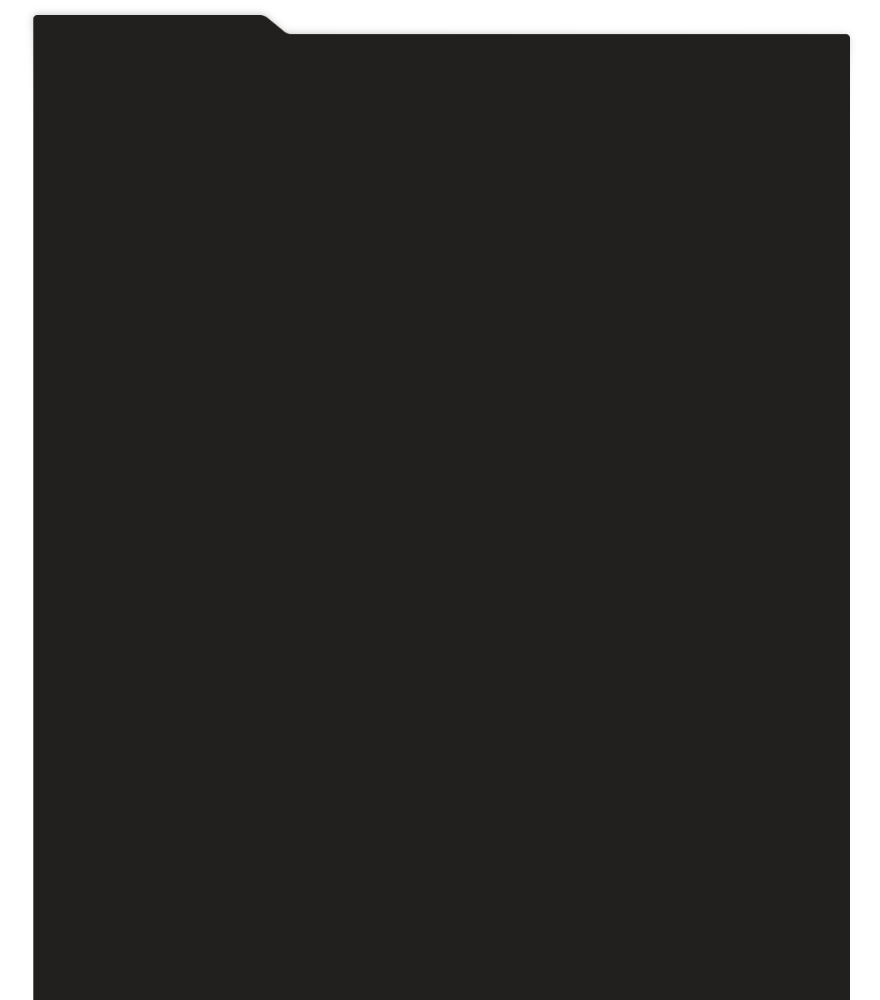
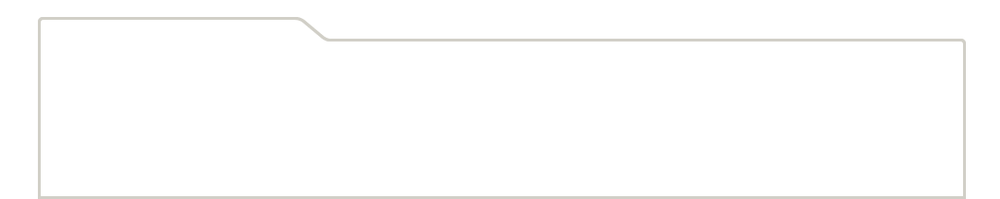
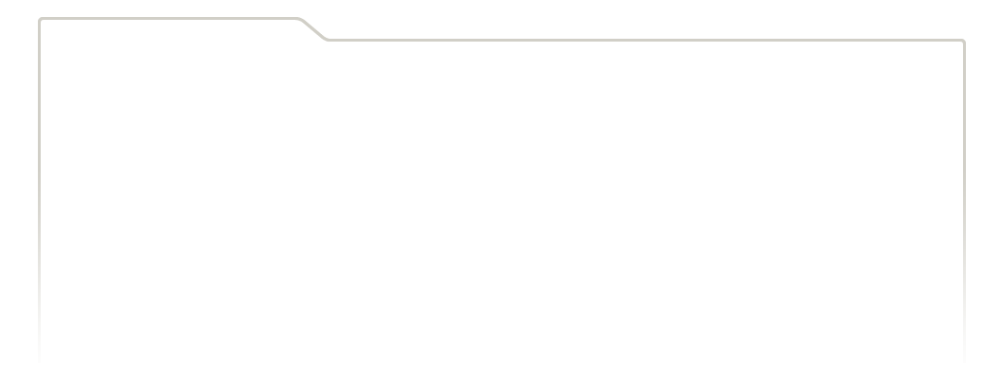
...
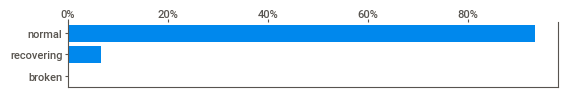
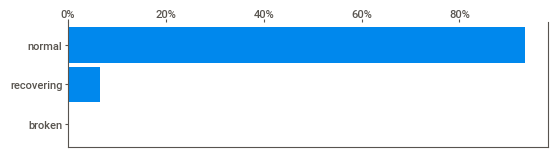
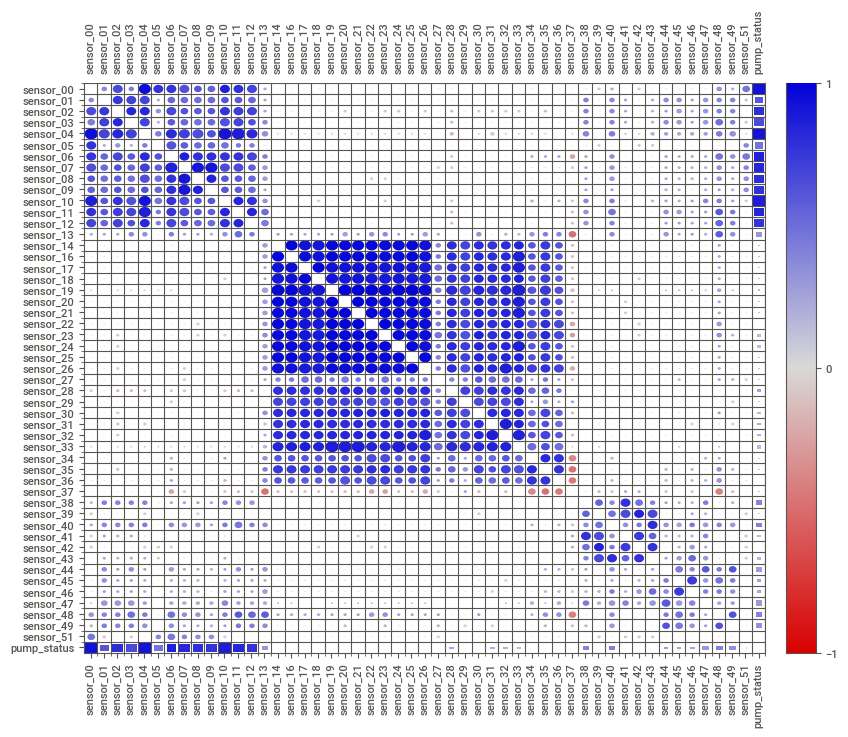
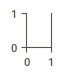
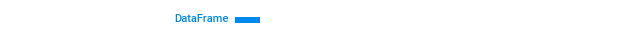

In [29]:
# Display the report
water_pump_df_report.show_html("./Assets/EDA/sweetviz/water_pump_df_report.html")
water_pump_df_report.show_notebook(w=1500, h=300)

Shape of your Data Set loaded: (220320, 52)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
Data Set Shape: 220320 rows, 52 cols
Too many columns to print
    Numeric Columns: ['sensor_00', 'sensor_01', 'sensor_02', 'sensor_03', 'sensor_04', 'sensor_05', 'sensor_06', 'sensor_07', 'sensor_08', 'sensor_09', 'sensor_10', 'sensor_11', 'sensor_12', 'sensor_13', 'sensor_14', 'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20', 'sensor_21', 'sensor_22', 'sensor_23', 'sensor_24', 'sensor_25', 'sensor_26', 'sensor_27', 'sensor_28', 'sensor_29', 'sensor_30']
    Integer-Categorical Columns: []
    String-Categorical Columns: []
    Factor-Categorical Columns: ['pump_status']
    String-Boolean Columns: []
    Numeric-Boolean Columns: []
    Discrete String Columns: []
    NLP text Columns: []
    Date Time Columns: ['datetime']
    ID Columns: []
    Columns that will not be considered in modeling: []
    52 Predictor

,datetime,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,sensor_10,sensor_11,sensor_12,sensor_13,sensor_14,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21,sensor_22,sensor_23,sensor_24,sensor_25,sensor_26,sensor_27,sensor_28,sensor_29,sensor_30,sensor_31,sensor_32,sensor_33,sensor_34,sensor_35,sensor_36,sensor_37,sensor_38,sensor_39,sensor_40,sensor_41,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_51,pump_status
0,2018-04-01 00:00:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,15.05353,37.22740,47.52422,31.11716,1.681353,419.5747,461.8781,466.3284,2.565284,665.3993,398.9862,880.0001,498.8926,975.9409,627.6740,741.7151,848.0708,429.0377,785.1935,684.9443,594.4445,682.8125,680.4416,433.7037,171.9375,341.9039,195.0655,90.32386,40.36458,31.51042,70.57291,30.989580,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,201.3889,normal
1,2018-04-01 00:01:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,15.05353,37.22740,47.52422,31.11716,1.681353,419.5747,461.8781,466.3284,2.565284,665.3993,398.9862,880.0001,498.8926,975.9409,627.6740,741.7151,848.0708,429.0377,785.1935,684.9443,594.4445,682.8125,680.4416,433.7037,171.9375,341.9039,195.0655,90.32386,40.36458,31.51042,70.57291,30.989580,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,201.3889,normal
2,2018-04-01 00:02:00,2.444734,47.35243,53.211800,46.397570,638.888900,73.54598,13.32465,16.03733,15.61777,15.01013,37.86777,48.17723,32.08894,1.708474,420.8480,462.7798,459.6364,2.500062,666.2234,399.9418,880.4237,501.3617,982.7342,631.1326,740.8031,849.8997,454.2390,778.5734,715.6266,661.5740,721.8750,694.7721,441.2635,169.9820,343.1955,200.9694,93.90508,41.40625,31.25000,69.53125,30.468750,31.770830,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,203.7037,normal
3,2018-04-01 00:03:00,2.460474,47.09201,53.168400,46.397568,628.125000,76.98898,13.31742,16.24711,15.69734,15.08247,38.57977,48.65607,31.67221,1.579427,420.7494,462.8980,460.8858,2.509521,666.0114,399.1046,878.8917,499.0430,977.7520,625.4076,739.2722,847.7579,474.8731,779.5091,690.4011,686.1111,754.6875,683.3831,446.2493,166.4987,343.9586,193.1689,101.04060,41.92708,31.51042,72.13541,30.468750,31.510420,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,203.1250,normal
4,2018-04-01 00:04:00,2.445718,47.13541,53.211800,46.397568,636.458300,76.58897,13.35359,16.21094,15.69734,15.08247,39.48939,49.06298,31.95202,1.683831,419.8926,461.4906,468.2206,2.604785,663.2111,400.5426,882.5874,498.5383,979.5755,627.1830,737.6033,846.9182,408.8159,785.2307,704.6937,631.4814,766.1458,702.4431,433.9081,164.7498,339.9630,193.8770,101.70380,42.70833,31.51042,76.82291,30.989580,31.510420,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,201.3889,normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220315,2018-08-31 23:55:00,2.407350,47.69965,50.520830,43.142361,634.722229,64.59095,15.11863,16.65220,15.65393,15.16204,43.17085,54.16052,38.05424,13.265320,420.7993,463.2318,458.3615,2.499117,676.6655,405.7680,894.5920,543.5801,1109.5010,611.1745,700.5885,796.5964,692.1138,779.2067,485.0358,691.6666,974.9999,927.6135,477.3156,266.0334,578.5221,817.5707,0.00000,47.13541,29.16667,71.61458,30.468750,30.208330,38.28125,68.287030,52.37268,48.32176,41.087960,212.3843,153.64580,231.1921,normal
220316,2018-08-31 23:56:00,2.400463,47.69965,50.564240,43.142361,630.902771,65.83363,15.15480,16.70284,15.65393,15.11863,43.21038,54.52602,38.53485,13.242270,422.1567,463.1928,468.4388,2.618476,676.6547,406.2575,895.5599,541.7014,1106.3710,609.4917,698.4915,800.1906,697.8002,797.5571,510.9510,672.2222,927.0833,907.9463,487.8679,262.2

Error in callback <function _draw_all_if_interactive at 0x00000269DC3621F0> (for post_execute):


ValueError: Image size of 1500x245200 pixels is too large. It must be less than 2^16 in each direction.

ValueError: Image size of 1500x245200 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1500x245200 with 1225 Axes>

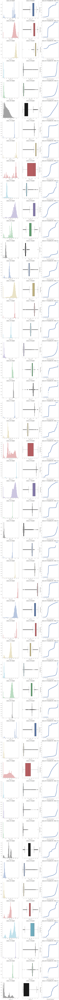

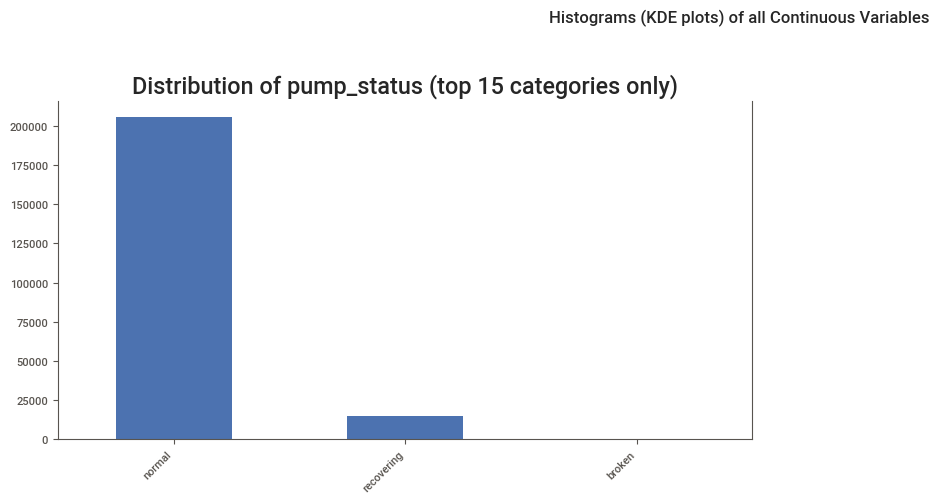

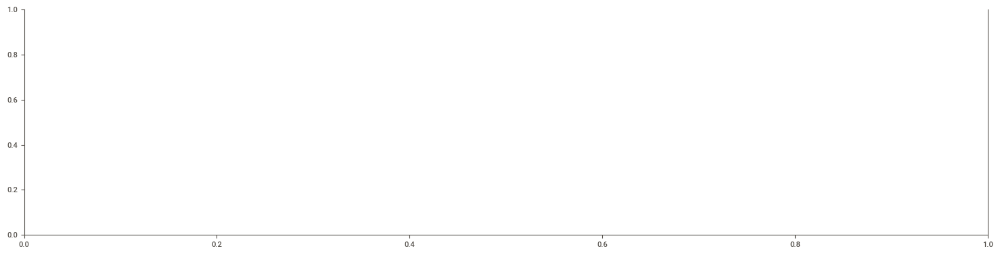

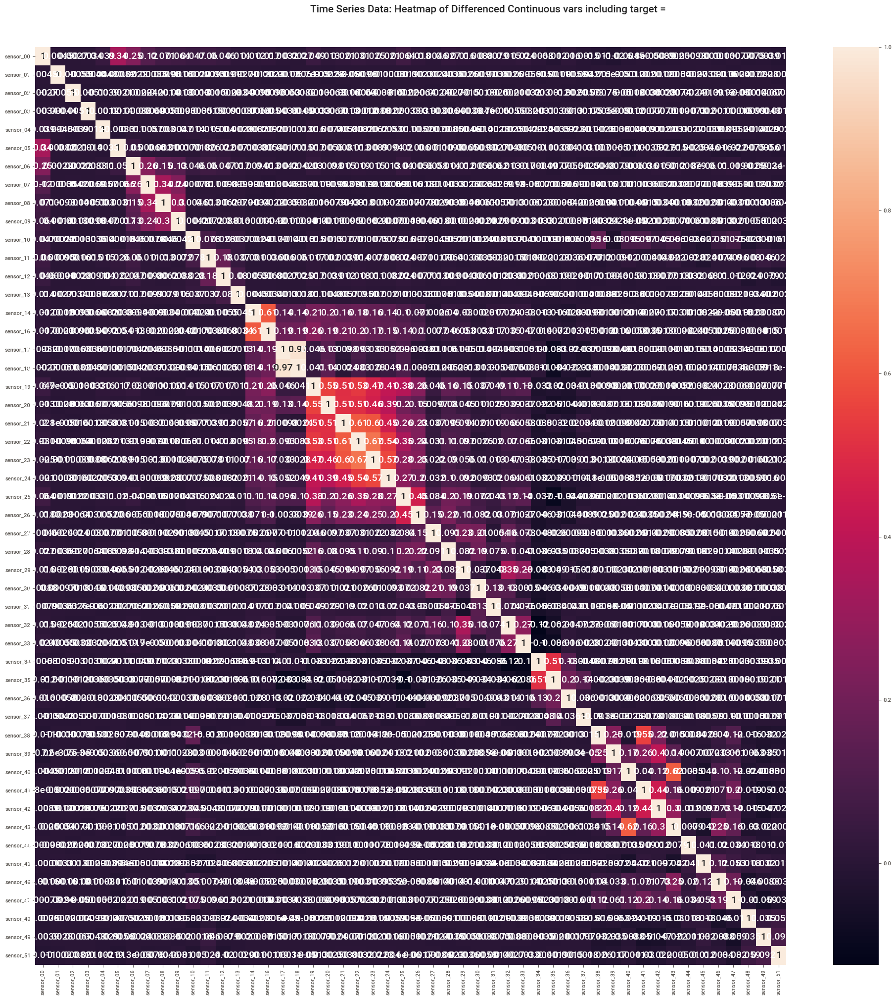

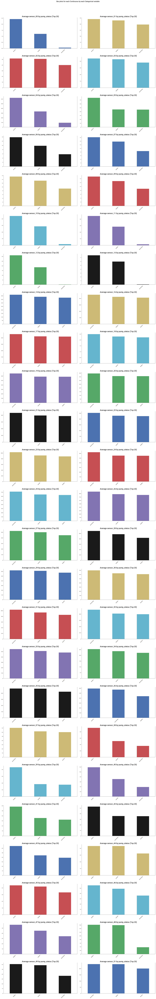

In [30]:
# EDA using autoviz
autoviz_custom(water_pump, save_plot_dir = "./Assets/EDA/AutoViz/water_pump")

In [31]:
# EDA using pandas-profiling
profile = ProfileReport(water_pump, explorative=True)

In [32]:
# Saving results
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [33]:
# Saving results
profile.to_file("./Assets/EDA/pandas-profiling/water_pump_df_EDA_pandas-profiling.html")

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

- This research uses time series data, so it will employ ffill imputation for missing value treatment (ffill - fill a missing value with a previously occuring value)

In [34]:
# Check if there are any missing values
# Print the count and percentage of missing values
print(f"Missing values in Water pump dataset:")
missing_count = water_pump.isnull().sum()
total_entries = len(water_pump)
missing_percentage = (missing_count / total_entries) * 100
missing_info = pd.DataFrame({
'Missing Count': missing_count,
'Missing Percentage': missing_percentage})
print(missing_info)
print("=" * 50)  # Separator between datasets

Missing values in Water pump dataset:
             Missing Count  Missing Percentage
datetime                 0            0.000000
sensor_00            10208            4.633261
sensor_01              369            0.167484
sensor_02               19            0.008624
sensor_03               19            0.008624
sensor_04               19            0.008624
sensor_05               19            0.008624
sensor_06             4798            2.177741
sensor_07             5451            2.474129
sensor_08             5107            2.317992
sensor_09             4595            2.085603
sensor_10               19            0.008624
sensor_11               19            0.008624
sensor_12               19            0.008624
sensor_13               19            0.008624
sensor_14               21            0.009532
sensor_16               31            0.014070
sensor_17               46            0.020879
sensor_18               46            0.020879
sensor_19             

- The highest missing values percentage is about 7% (6.982117%). With this insight the researchers will impute the rest of the missing values as to not discard data that may be useful for the modelling phase
- This research uses forward fill for data imputation to respect the temporal order of the dataset
- Also, the forward fill does not leak data from the future as compared to the backward fill

In [35]:
# ffill imputation
water_pump.fillna(method='ffill', inplace=True)

In [36]:
# Check if there are any missing values
# Print the count and percentage of missing values
print(f"Missing values in Water pump dataset:")
missing_count = water_pump.isnull().sum()
total_entries = len(water_pump)
missing_percentage = (missing_count / total_entries) * 100
missing_info = pd.DataFrame({
'Missing Count': missing_count,
'Missing Percentage': missing_percentage})
print(missing_info)
print("=" * 50)  # Separator between datasets

Missing values in Water pump dataset:
             Missing Count  Missing Percentage
datetime                 0                 0.0
sensor_00                0                 0.0
sensor_01                0                 0.0
sensor_02                0                 0.0
sensor_03                0                 0.0
sensor_04                0                 0.0
sensor_05                0                 0.0
sensor_06                0                 0.0
sensor_07                0                 0.0
sensor_08                0                 0.0
sensor_09                0                 0.0
sensor_10                0                 0.0
sensor_11                0                 0.0
sensor_12                0                 0.0
sensor_13                0                 0.0
sensor_14                0                 0.0
sensor_16                0                 0.0
sensor_17                0                 0.0
sensor_18                0                 0.0
sensor_19             

### Feature Engineering

In [37]:
# Set the datetime column as the index
water_pump = water_pump.set_index("datetime")

Datetime features from water_pump data

In [38]:
dtf_water_pump = DatetimeFeatures(
    # the datetime variable
    variables="index",

    # the features we want to create
    features_to_extract=[
        "month",
        "week",
        "day_of_week",
        "day_of_month",
        "hour",
        "weekend",
    ],
    drop_original=False,
)

print("data size before")
print(water_pump.shape)

# Extract the datetime features
# Add the variables to the original data.
water_pump = dtf_water_pump.fit_transform(water_pump)

print("data size after")
print(water_pump.shape)

# Show new variables
water_pump.head(3)

data size before
(220320, 51)
data size after
(220320, 57)


,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,sensor_10,sensor_11,sensor_12,sensor_13,sensor_14,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21,sensor_22,sensor_23,sensor_24,sensor_25,sensor_26,sensor_27,sensor_28,sensor_29,sensor_30,sensor_31,sensor_32,sensor_33,sensor_34,sensor_35,sensor_36,sensor_37,sensor_38,sensor_39,sensor_40,sensor_41,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_51,pump_status,month,week,day_of_week,day_of_month,hour,weekend
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,2.465394,47.09201,53.2118,46.31076,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,37.22740,47.52422,31.11716,1.681353,419.5747,461.8781,466.3284,2.565284,665.3993,398.9862,880.0001,498.8926,975.9409,627.6740,741.7151,848.0708,429.0377,785.1935,684.9443,594.4445,682.8125,680.4416,433.7037,171.9375,341.9039,195.0655,90.32386,40.36458,31.51042,70.57291,30.98958,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,201.3889,normal,4,13,6,1,0,1
2018-04-01 00:01:00,2.465394,47.09201,53.2118,46.31076,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,37.22740,47.52422,31.11716,1.681353,419.5747,461.8781,466.3284,2.565284,665.3993,398.9862,880.0001,498.8926,975.9409,627.6740,741.7151,848.0708,429.0377,785.1935,684.9443,594.4445,682.8125,680.4416,433.7037,171.9375,341.9039,195.0655,90.32386,40.36458,31.51042,70.57291,30.98958,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,201.3889,normal,4,13,6,1,0,1
2018-04-01 00:02:00,2.444734,47.35243,53.2118,46.39757,638.8889,73.54598,13.32465,16.03733,15.61777,15.01013,37.86777,48.17723,32.08894,1.708474,420.8480,462.7798,459.6364,2.500062,666.2234,399.9418,880.4237,501.3617,982.7342,631.1326,740.8031,849.8997,454.2390,778.5734,715.6266,661.5740,721.8750,694.7721,441.2635,169.9820,343.1955,200.9694,93.90508,41.40625,31.25000,69.53125,30.46875,31.770830,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,203.7037,normal,4,13,6,1,0,1


Lag Features from Water pump
- For the previous hours (t-1)
- For the same hour on the previous day (t-24)

In [39]:
# Select the variables to transform.
temp_variables = water_pump.loc[:, water_pump.columns.str.contains("sensor_")].columns.tolist()

In [40]:
# Add the lag features.
lagf_water_pump = LagFeatures(
    variables=temp_variables,  # the input variables
    freq=["1H", "24H"],  # move 1 hr and 24 hrs forward
    missing_values="ignore",
)

print("data size before")
print(water_pump.shape)

# Add the lag features.
water_pump = lagf_water_pump.fit_transform(water_pump)

print("data size after")
print(water_pump.shape)

# Show new variables
water_pump[[v for v in water_pump.columns if "lag" in v]].head(3)

data size before
(220320, 57)
data size after
(220320, 157)


,sensor_00_lag_1H,sensor_01_lag_1H,sensor_02_lag_1H,sensor_03_lag_1H,sensor_04_lag_1H,sensor_05_lag_1H,sensor_06_lag_1H,sensor_07_lag_1H,sensor_08_lag_1H,sensor_09_lag_1H,sensor_10_lag_1H,sensor_11_lag_1H,sensor_12_lag_1H,sensor_13_lag_1H,sensor_14_lag_1H,sensor_16_lag_1H,sensor_17_lag_1H,sensor_18_lag_1H,sensor_19_lag_1H,sensor_20_lag_1H,sensor_21_lag_1H,sensor_22_lag_1H,sensor_23_lag_1H,sensor_24_lag_1H,sensor_25_lag_1H,sensor_26_lag_1H,sensor_27_lag_1H,sensor_28_lag_1H,sensor_29_lag_1H,sensor_30_lag_1H,sensor_31_lag_1H,sensor_32_lag_1H,sensor_33_lag_1H,sensor_34_lag_1H,sensor_35_lag_1H,sensor_36_lag_1H,sensor_37_lag_1H,sensor_38_lag_1H,sensor_39_lag_1H,sensor_40_lag_1H,sensor_41_lag_1H,sensor_42_lag_1H,sensor_43_lag_1H,sensor_44_lag_1H,sensor_45_lag_1H,sensor_46_lag_1H,sensor_47_lag_1H,sensor_48_lag_1H,sensor_49_lag_1H,sensor_51_lag_1H,sensor_00_lag_24H,sensor_01_lag_24H,sensor_02_lag_24H,sensor_03_lag_24H,sensor_04_lag_24H,sensor_05_lag_24H,sensor_06_lag_24H,sensor_07_lag_24H,sensor_08_lag_24H,sensor_09_lag_24H,sensor_10_lag_24H,sensor_11_lag_24H,sensor_12_lag_24H,sensor_13_lag_24H,sensor_14_lag_24H,sensor_16_lag_24H,sensor_17_lag_24H,sensor_18_lag_24H,sensor_19_lag_24H,sensor_20_lag_24H,sensor_21_lag_24H,sensor_22_lag_24H,sensor_23_lag_24H,sensor_24_lag_24H,sensor_25_lag_24H,sensor_26_lag_24H,sensor_27_lag_24H,sensor_28_lag_24H,sensor_29_lag_24H,sensor_30_lag_24H,sensor_31_lag_24H,sensor_32_lag_24H,sensor_33_lag_24H,sensor_34_lag_24H,sensor_35_lag_24H,sensor_36_lag_24H,sensor_37_lag_24H,sensor_38_lag_24H,sensor_39_lag_24H,sensor_40_lag_24H,sensor_41_lag_24H,sensor_42_lag_24H,sensor_43_lag_24H,sensor_44_lag_24H,sensor_45_lag_24H,sensor_46_lag_24H,sensor_47_lag_24H,sensor_48_lag_24H,sensor_49_lag_24H,sensor_51_lag_24H
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-04-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-04-01 00:02:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Window features

- We take the average of the previous 3 hours of the time series to predict the current hour.

In [41]:
winf_water_pump = WindowFeatures(
    variables=temp_variables,  # the input variables
    window="3H",  # average of 3 previous hours
    freq="1H",  # move 1 hr forward
    missing_values="ignore",
)

print("data size before")
print(water_pump.shape)

# Add the window features.
water_pump = winf_water_pump.fit_transform(water_pump)

print("data size after")
print(water_pump.shape)

# Show new variables
water_pump[[v for v in water_pump.columns if "window" in v]].head(3)

data size before
(220320, 157)
data size after
(220320, 207)


,sensor_00_window_3H_mean,sensor_01_window_3H_mean,sensor_02_window_3H_mean,sensor_03_window_3H_mean,sensor_04_window_3H_mean,sensor_05_window_3H_mean,sensor_06_window_3H_mean,sensor_07_window_3H_mean,sensor_08_window_3H_mean,sensor_09_window_3H_mean,sensor_10_window_3H_mean,sensor_11_window_3H_mean,sensor_12_window_3H_mean,sensor_13_window_3H_mean,sensor_14_window_3H_mean,sensor_16_window_3H_mean,sensor_17_window_3H_mean,sensor_18_window_3H_mean,sensor_19_window_3H_mean,sensor_20_window_3H_mean,sensor_21_window_3H_mean,sensor_22_window_3H_mean,sensor_23_window_3H_mean,sensor_24_window_3H_mean,sensor_25_window_3H_mean,sensor_26_window_3H_mean,sensor_27_window_3H_mean,sensor_28_window_3H_mean,sensor_29_window_3H_mean,sensor_30_window_3H_mean,sensor_31_window_3H_mean,sensor_32_window_3H_mean,sensor_33_window_3H_mean,sensor_34_window_3H_mean,sensor_35_window_3H_mean,sensor_36_window_3H_mean,sensor_37_window_3H_mean,sensor_38_window_3H_mean,sensor_39_window_3H_mean,sensor_40_window_3H_mean,sensor_41_window_3H_mean,sensor_42_window_3H_mean,sensor_43_window_3H_mean,sensor_44_window_3H_mean,sensor_45_window_3H_mean,sensor_46_window_3H_mean,sensor_47_window_3H_mean,sensor_48_window_3H_mean,sensor_49_window_3H_mean,sensor_51_window_3H_mean
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-04-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-04-01 00:02:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Periodic features
- We transform the month and the hour with the sine and cosine to have a periodic representation of the features.

In [42]:
# Create features that capture the cyclical representation.
cyclicf_water_pump = CyclicalFeatures(
    # The features we want to transform.
    variables=["month", "hour"],
    # Whether to drop the original features.
    drop_original=False,
)

print("data size before")
print(water_pump.shape)

water_pump = cyclicf_water_pump.fit_transform(
    water_pump)

print("data size after")
print(water_pump.shape)

water_pump[[
    v for v in water_pump.columns if "month" in v or "hour" in v]].head(3)

data size before
(220320, 207)
data size after
(220320, 211)


,month,day_of_month,hour,month_sin,month_cos,hour_sin,hour_cos
datetime,,,,,,,
2018-04-01 00:00:00,4,1,0,1.224647e-16,-1.0,0.0,1.0
2018-04-01 00:01:00,4,1,0,1.224647e-16,-1.0,0.0,1.0
2018-04-01 00:02:00,4,1,0,1.224647e-16,-1.0,0.0,1.0


In [43]:
# Reset index because when we save the file index is False
water_pump.reset_index(inplace=True)

Rearrange columns, putting the target variable ("pump_status") at the end

In [44]:
# Rearrange columns, putting the target variable ("pump_status") at the end
water_pump = water_pump[[col for col in water_pump.columns if col != 'pump_status'] + ['pump_status']]

In [45]:
# Check if there are any missing values
# Print the count and percentage of missing values
print(f"Missing values in Water pump dataset:")
missing_count = water_pump.isnull().sum()
total_entries = len(water_pump)
missing_percentage = (missing_count / total_entries) * 100
missing_info = pd.DataFrame({
'Missing Count': missing_count,
'Missing Percentage': missing_percentage})
print(missing_info)
print("=" * 50)  # Separator between datasets

Missing values in Water pump dataset:
                          Missing Count  Missing Percentage
datetime                              0            0.000000
sensor_00                             0            0.000000
sensor_01                             0            0.000000
sensor_02                             0            0.000000
sensor_03                             0            0.000000
sensor_04                             0            0.000000
sensor_05                             0            0.000000
sensor_06                             0            0.000000
sensor_07                             0            0.000000
sensor_08                             0            0.000000
sensor_09                             0            0.000000
sensor_10                             0            0.000000
sensor_11                             0            0.000000
sensor_12                             0            0.000000
sensor_13                             0            0.000000
se

- Missing values were introduced after feature engineering due to values that did not exist in the first place, eg, lag of 3 previous hours, this won't exist for the very first value, as a result the value cannot be computed
- The missing values are less than 1%
- Therefore they are dropped

In [46]:
# We drop the observations with NA.

print("data size before")
print(water_pump.shape)

drop_imputer = DropMissingData()

print("data size before")
water_pump = drop_imputer.fit_transform(water_pump)

print(water_pump.shape)

data size before
(220320, 212)
data size before
(218880, 212)


In [47]:
# Check if there are any missing values
# Print the count and percentage of missing values
print(f"Missing values in Water pump dataset:")
missing_count = water_pump.isnull().sum()
total_entries = len(water_pump)
missing_percentage = (missing_count / total_entries) * 100
missing_info = pd.DataFrame({
'Missing Count': missing_count,
'Missing Percentage': missing_percentage})
print(missing_info)
print("=" * 50)  # Separator between datasets

Missing values in Water pump dataset:
                          Missing Count  Missing Percentage
datetime                              0                 0.0
sensor_00                             0                 0.0
sensor_01                             0                 0.0
sensor_02                             0                 0.0
sensor_03                             0                 0.0
sensor_04                             0                 0.0
sensor_05                             0                 0.0
sensor_06                             0                 0.0
sensor_07                             0                 0.0
sensor_08                             0                 0.0
sensor_09                             0                 0.0
sensor_10                             0                 0.0
sensor_11                             0                 0.0
sensor_12                             0                 0.0
sensor_13                             0                 0.0
se

In [48]:
skim(water_pump)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types               Categories                                        │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓ ┏━━━━━━━━━━━━━━━━━━━━━━━┓                                │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃ ┃ Categorical Variables ┃                                │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩ ┡━━━━━━━━━━━━━━━━━━━━━━━┩                                │
│ │ Number of rows    │ 218880 │ │ float64     │ 204   │ │ pump_status           │                                │
│ │ Number of columns │ 212    │ │ int32       │ 6     │ └───────────────────────┘                                │
│ └───────────────────┴────────┘ │ datetime64  │ 1     │                                                          │
│                                │ category    │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━┳━━━━━━━┳━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_name             ┃ NA  ┃ NA %  ┃ mean      ┃ sd    ┃ p0      ┃ p25    ┃ p75      ┃ p100    ┃ hist   ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━╇━━━━━━━╇━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩  │
│ │ sensor_00               │   0 │     0 │       2.3 │  0.59 │       0 │    2.4 │      2.5 │     2.5 │      █ │  │
│ │ sensor_01               │   0 │     0 │        48 │   3.3 │       0 │     46 │       49 │      57 │     ▄█ │  │
│ │ sensor_02               │   0 │     0 │        51 │   3.7 │      33 │     50 │       53 │      56 │    ▁█▅ │  │
│ │ sensor_03               │   0 │     0 │        44 │   2.4 │      32 │     43 │       45 │      48 │    ▂█▃ │  │
│ │ sensor_04               │   0 │     0 │       590 │   140 │     2.8 │    630 │      640 │     800 │     █  │  │
│ │ sensor_05               │   0 │     0 │        73 │    17 │       0 │     70 │       81 │     100 │    ▁█▂ │  │
│ │ sensor_06               │   0 │     0 │        13 │   2.9 │   0.014 │     13 │       15 │      22 │    █▁  │  │
│ │ sensor_07               │   0 │     0 │        15 │   3.2 │       0 │     16 │       16 │      24 │    ▂█  │  │
│ │ sensor_08               │   0 │     0 │        15 │     3 │   0.029 │     15 │       16 │      24 │     █  │  │
│ │ sensor_09               │   0 │     0 │        14 │     3 │       0 │     15 │       15 │      25 │     █  │  │
│ │ sensor_10               │   0 │     0 │        41 │    12 │       0 │     41 │       47 │      76 │ ▁ ▁█▁  │  │
│ │ sensor_11               │   0 │     0 │        42 │    13 │       0 │     39 │       50 │      60 │ ▁  ▃█▄ │  │
│ │ sensor_12               │   0 │     0 │        29 │    10 │       0 │     29 │       35 │      45 │ ▁ ▁▂█▁ │  │
│ │ sensor_13               │   0 │     0 │       7.1 │   6.9 │       0 │    1.5 │       13 │      31 │  █▁▃▂  │  │
│ │ sensor_14               │   0 │     0 │       380 │   110 │      32 │    420 │      420 │     500 │ ▁   █▁ │  │
│ │ sensor_16               │   0 │     0 │       420 │   130 │       0 │    460 │      460 │     740 │  ▁  █  │  │
│ │ sensor_17               │   0 │     0 │       420 │   130 │       0 │    450 │      470 │     600 │ ▁   █  │  │
│ │ sensor_18               │   0 │     0 │       2.3 │  0.77 │       0 │    2.4 │      2.6 │     4.9 │  ▁ ▁█  │  │
│ │ sensor_19               │   0 │     0 │       590 │   200 │       0 │    660 │      670 │     880 │ ▁   █  │  │
│ │ sensor_20               │   0 │     0 │       360 │   100 │       0 │    400 │      400 │     450 │ ▁    █ │  │
│ │ sensor_21               │   0 │     0 │       800 │ 

In [49]:
print(f"The total number of rows: {water_pump.shape[0]}")
print(f"The total number of columns: {water_pump.shape[1]}")

The total number of rows: 218880
The total number of columns: 212


In [50]:
water_pump.head(3)

,datetime,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,sensor_10,sensor_11,sensor_12,sensor_13,sensor_14,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21,sensor_22,sensor_23,sensor_24,sensor_25,sensor_26,sensor_27,sensor_28,sensor_29,sensor_30,sensor_31,sensor_32,sensor_33,sensor_34,sensor_35,sensor_36,sensor_37,sensor_38,sensor_39,sensor_40,sensor_41,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,...,sensor_05_window_3H_mean,sensor_06_window_3H_mean,sensor_07_window_3H_mean,sensor_08_window_3H_mean,sensor_09_window_3H_mean,sensor_10_window_3H_mean,sensor_11_window_3H_mean,sensor_12_window_3H_mean,sensor_13_window_3H_mean,sensor_14_window_3H_mean,sensor_16_window_3H_mean,sensor_17_window_3H_mean,sensor_18_window_3H_mean,sensor_19_window_3H_mean,sensor_20_window_3H_mean,sensor_21_window_3H_mean,sensor_22_window_3H_mean,sensor_23_window_3H_mean,sensor_24_window_3H_mean,sensor_25_window_3H_mean,sensor_26_window_3H_mean,sensor_27_window_3H_mean,sensor_28_window_3H_mean,sensor_29_window_3H_mean,sensor_30_window_3H_mean,sensor_31_window_3H_mean,sensor_32_window_3H_mean,sensor_33_window_3H_mean,sensor_34_window_3H_mean,sensor_35_window_3H_mean,sensor_36_window_3H_mean,sensor_37_window_3H_mean,sensor_38_window_3H_mean,sensor_39_window_3H_mean,sensor_40_window_3H_mean,sensor_41_window_3H_mean,sensor_42_window_3H_mean,sensor_43_window_3H_mean,sensor_44_window_3H_mean,sensor_45_window_3H_mean,sensor_46_window_3H_mean,sensor_47_window_3H_mean,sensor_48_window_3H_mean,sensor_49_window_3H_mean,sensor_51_window_3H_mean,month_sin,month_cos,hour_sin,hour_cos,pump_status
1440,2018-04-02 00:00:00,2.459491,45.83333,52.34375,44.791664,639.5833,78.57581,13.09317,16.16753,15.49479,15.11863,39.10618,48.76909,34.88964,1.630659,419.4145,462.7810,458.7330,2.510471,664.6292,399.4448,880.0466,451.3454,948.0187,626.6476,738.9390,848.2383,454.3949,777.7931,692.1740,657.8704,698.4375,675.0967,441.6788,169.3124,326.0179,196.0043,109.8206,40.36458,31.51042,68.22916,29.16667,30.98958,39.32291,46.00694,50.92593,37.32639,36.16898,175.3472,83.91203,...,77.020287,13.098396,16.162871,15.674552,15.094161,40.335557,49.143627,35.166382,1.352914,420.214860,462.915107,463.215378,2.544315,665.871420,399.248133,879.604422,449.655568,949.189458,627.852071,740.170378,849.685367,450.823437,780.756197,700.955470,657.932087,751.339662,702.056881,459.833726,167.040272,326.382823,200.904355,103.390600,44.231768,31.889466,65.983793,31.041665,31.176214,38.136571,45.298032,44.645383,40.049511,37.763631,191.173162,77.284271,220.801180,1.224647e-16,-1.0,0.0,1.0,normal
1441,2018-04-02 00:01:00,2.459491,45.83333,52.34375,44.791664,639.5833,78.57581,13.09317,16.16753,15.49479,15.11863,39.10618,48.76909,34.88964,1.630659,419.4145,462.7810,458.7330,2.510471,664.6292,399.4448,880.0466,451.3454,948.0187,626.6476,738.9390,848.2383,454.3949,777.7931,692.1740,657.8704,698.4375,675.0967,441.6788,169.3124,326.0179,196.0043,109.8206,40.36458,31.51042,68.22916,29.16667,30.98958,39.32291,46.00694,50.92593,37.32639,36.16898,175.3472,83.91203,...,76.995564,13.098717,16.162629,15.672744,15.094161,40.352913,49.148724,35.173750,1.352835,420.209148,462.930158,463.259462,2.544881,665.885041,399.250921,879.592396,449.640655,949.193829,627.843914,740.108532,849.637168,450.501454,780.719717,700.915437,657.605441,751.458297,701.966277,459.883357,167.014344,326.266168,200.896665,103.427431,44.244789,31.882232,65.918689,31.041665,31.176214,38.107636,45.256237,44.701646,40.041473,37.760416,190.951326,77.363039,220.791535,1.224647e-16,-1.0,0.0,1.0,normal
1442,2018-04-02 00:02:00,2.449653,45.74652,52.30035,44.791664,634.8380,79.06493,13.12211,16.13136,15.56713,15.11863,39.54170,49.36325,34.70763,1.698600,420.7122,465.3882,465.1732,2.568181,666.6492,400.7916,882.5840,451.3930,952.2055,630.6781,737.2679,849.6859,431.9657,780.9681,698.7738,662.5000,770.8333,671.6877,441.1618,169.8214,324.0824,200.1605,104.2979,39.32291,3

In [51]:
water_pump.tail(3)

,datetime,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,sensor_10,sensor_11,sensor_12,sensor_13,sensor_14,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21,sensor_22,sensor_23,sensor_24,sensor_25,sensor_26,sensor_27,sensor_28,sensor_29,sensor_30,sensor_31,sensor_32,sensor_33,sensor_34,sensor_35,sensor_36,sensor_37,sensor_38,sensor_39,sensor_40,sensor_41,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,...,sensor_05_window_3H_mean,sensor_06_window_3H_mean,sensor_07_window_3H_mean,sensor_08_window_3H_mean,sensor_09_window_3H_mean,sensor_10_window_3H_mean,sensor_11_window_3H_mean,sensor_12_window_3H_mean,sensor_13_window_3H_mean,sensor_14_window_3H_mean,sensor_16_window_3H_mean,sensor_17_window_3H_mean,sensor_18_window_3H_mean,sensor_19_window_3H_mean,sensor_20_window_3H_mean,sensor_21_window_3H_mean,sensor_22_window_3H_mean,sensor_23_window_3H_mean,sensor_24_window_3H_mean,sensor_25_window_3H_mean,sensor_26_window_3H_mean,sensor_27_window_3H_mean,sensor_28_window_3H_mean,sensor_29_window_3H_mean,sensor_30_window_3H_mean,sensor_31_window_3H_mean,sensor_32_window_3H_mean,sensor_33_window_3H_mean,sensor_34_window_3H_mean,sensor_35_window_3H_mean,sensor_36_window_3H_mean,sensor_37_window_3H_mean,sensor_38_window_3H_mean,sensor_39_window_3H_mean,sensor_40_window_3H_mean,sensor_41_window_3H_mean,sensor_42_window_3H_mean,sensor_43_window_3H_mean,sensor_44_window_3H_mean,sensor_45_window_3H_mean,sensor_46_window_3H_mean,sensor_47_window_3H_mean,sensor_48_window_3H_mean,sensor_49_window_3H_mean,sensor_51_window_3H_mean,month_sin,month_cos,hour_sin,hour_cos,pump_status
220317,2018-08-31 23:57:00,2.396528,47.69965,50.520830,43.142361,625.925903,67.29445,15.08970,16.70284,15.69734,15.11863,43.12836,55.11779,38.52678,13.18866,420.2166,462.4065,468.6293,2.620500,677.3162,407.1144,892.2204,542.8578,1106.698,610.9940,703.1645,800.3767,704.6601,799.3120,492.7720,689.3519,924.4791,926.8102,494.1249,260.8372,553.8872,805.5605,0.0,46.09375,28.64583,77.08333,29.947920,30.208330,39.06250,65.39352,48.90046,48.03241,40.798610,217.3032,155.3819,...,69.032347,15.105814,16.662127,15.673346,15.089459,42.838728,49.516471,36.703760,13.132404,420.417969,463.536412,463.481083,2.550899,676.436783,405.935632,894.326289,542.388207,1108.685550,610.027306,700.346733,800.483231,514.393524,800.206449,498.872334,681.195974,902.876089,899.813882,480.390209,252.689228,539.841662,795.956461,0.068641,44.920425,32.324940,73.479453,29.596354,30.315393,41.592879,59.850823,61.537101,60.297711,44.536071,293.467078,113.183191,225.099666,-2.449294e-16,1.0,-2.449294e-16,1.0,normal
220318,2018-08-31 23:58:00,2.406366,47.69965,50.520832,43.142361,635.648100,65.09175,15.11863,16.56539,15.74074,15.11863,42.35746,55.99321,38.89159,13.17346,420.5700,457.0362,459.7941,2.514596,672.6165,404.3277,887.9969,539.3630,1103.955,605.7183,697.3713,793.7070,706.9692,793.0610,490.2170,687.0370,931.7708,915.4362,484.1161,261.3184,559.4439,807.0808,0.0,45.83333,28.38542,78.64583,29.947916,30.208332,40.62500,64.23611,47.74306,48.32176,40.509258,222.5116,153.9352,...,69.034109,15.105211,16.662690,15.673587,15.089298,42.825859,49.514514,36.717139,13.132592,420.431236,463.544757,463.460656,2.550676,676.418994,405.931527,894.306418,542.372974,1108.678261,610.016522,700.335909,800.467336,511.151108,800.270561,498.864831,681.296283,902.983149,899.834957,480.409229,252.741755,540.002121,796.035442,0.068641,44.882809,32.280091,73.504048,29.589120,30.303819,41.594325,59.754372,61.521026,60.317001,44.519996,293.576388,113.371269,225.184864,-2.449294e-16,1.0,-2.449294e-16,1.0,normal
220319,2018-08-31 23:59:00,2.396528,47.69965,50.520832,43.142361,639.814800,65.45634,15.11863,16.65220,15.65393,15.01013,42.62814,56.49642,39.40957,13.12593,421.2080,468.9915,456.5726,2.487299,676.5834,405.6293,897.8508,542.0950,1108.827,608.5364,698.0792,800.0387,703.6251,800.2143,496.4068,686.1111,917.7083,926.3979,489.0367,258.4387,558.

In [52]:
# Reduce size of dataframe
water_pump = PandaReducer().reduce(water_pump)

# Cast to categorical
to_cast = return_categoricals(water_pump, threshold=5)
water_pump = to_categorical(to_cast, water_pump)

water_pump.info(verbose=True)

Dataset reduced 50.91% : 354.23 to 173.88 MB in 19.14 seconds
<class 'pandas.core.frame.DataFrame'>
Int64Index: 218880 entries, 1440 to 220319
Data columns (total 212 columns):
 #    Column                    Dtype         
---   ------                    -----         
 0    datetime                  datetime64[ns]
 1    sensor_00                 float32       
 2    sensor_01                 float32       
 3    sensor_02                 float32       
 4    sensor_03                 float32       
 5    sensor_04                 float32       
 6    sensor_05                 float32       
 7    sensor_06                 float32       
 8    sensor_07                 float32       
 9    sensor_08                 float32       
 10   sensor_09                 float32       
 11   sensor_10                 float32       
 12   sensor_11                 float32       
 13   sensor_12                 float32       
 14   sensor_13                 float32       
 15   sensor_14         

Save water_pump as a CSV for the next steps

In [53]:
# data_path_clean = "../../data/d_pump_cleaned/"

In [54]:
# water_pump.to_csv(f"{data_path_clean}/final_pdm_pump_cleaned.csv", index=False, header=True)